
You are a lead data scientist on a project regarding maternal health, you are provided with a dataset regarding featal health. (Please find the dataset in the data folder given). These are your instructions
1 - Use that dataset to do: EDA, Clean the data
2 - Use Pandas Profiling to export a pdf report of your data (explain how the report informs your future decisions)
3 - Apply any needed transformations if possible.
4 - Choose a proper evaluation metric for your project.
5 - Do model spot checking to find the best model for your use.
6 - Build the chosen model
7 - Evaluate bias vs variance on your model and present your results.

Note:
- Please follow instructions!
- You have to explain in detail every step you are executing in your own words, your result will be based on how well you explain what steps you are executing.
- Students are allowed to use public resources off the internet for their research, however students are not allowed to copy and paste code for this assignment (If you are caught, you will fail this assignment, you have been warned: especially chatGpt.)
- This is a graded individual assignment any malpractice will lead to losing of points, this assignment contributes a great percentage to your final grade.
- All assignments must be handed in by Close of Business next Wednesday by 6:00PM Date: 3rd - May - 2023
- All your assignments will be handed in by means of a pull request to my original repository.
- Please name your pull requests as per previously instructed, you will not get warnings for failing to do this.
- Your work should be saved in the Project Folder (Create your own folder and give the folder your name.)

In order to achieve the above work, I need to import all the below libraries which include the Pandas for Data preprocessing
Numpy for mathematical handling, matplotlib and manu other from the Sklearn for the modeling

In [150]:
# Importing all necessary packages
import warnings
warnings.simplefilter(action ="ignore")
warnings.filterwarnings('ignore')
from collections import Counter
import numpy as np
import pandas as pd
# these are used for visualization
import matplotlib.pyplot as plt
import seaborn as sns
# we import the following for algorithms
import ydata_profiling as pr
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.svm import LinearSVC
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import precision_score, recall_score, confusion_matrix, classification_report, accuracy_score, f1_score
from sklearn import metrics
from sklearn.metrics import roc_curve, auc, roc_auc_score
np.random.seed(0)

I want to read in my data and we use pandas for this.
my data is in the same folder that i am working so will just call its name without specifying the __path__
but in case it was in a different directory, i would have specified the path.

In [151]:
#reading in data
data = pd.read_csv("fetal_health.csv")
#print out the first 7 rows
data.head(7)


,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
0,120.0,0.000,0.0,0.000,0.000,0.0,0.000,73.0,0.5,43.0,...,62.0,126.0,2.0,0.0,120.0,137.0,121.0,73.0,1.0,2.0
1,132.0,0.006,0.0,0.006,0.003,0.0,0.000,17.0,2.1,0.0,...,68.0,198.0,6.0,1.0,141.0,136.0,140.0,12.0,0.0,1.0
2,133.0,0.003,0.0,0.008,0.003,0.0,0.000,16.0,2.1,0.0,...,68.0,198.0,5.0,1.0,141.0,135.0,138.0,13.0,0.0,1.0
3,134.0,0.003,0.0,0.008,0.003,0.0,0.000,16.0,2.4,0.0,...,53.0,170.0,11.0,0.0,137.0,134.0,137.0,13.0,1.0,1.0
4,132.0,0.007,0.0,0.008,0.000,0.0,0.000,16.0,2.4,0.0,...,53.0,170.0,9.0,0.0,137.0,136.0,138.0,11.0,1.0,1.0
5,134.0,0.001,0.0,0.010,0.009,0.0,0.002,26.0,5.9,0.0,...,50.0,200.0,5.0,3.0,76.0,107.0,107.0,170.0,0.0,3.0
6,134.0,0.001,0.0,0.013,0.008,0.0,0.003,29.0,6.3,0.0,...,50.0,200.0,6.0,3.0,71.0,107.0,106.0,215.0,0.0,3.0


# FIRST STEP
EDA is a phenomenon under data analysis used for gaining a better understanding of data aspects like: 
– main features of data 
– variables and relationships that hold between them 
– identifying which variables are important for our problem 
We shall look at various exploratory data analysis methods like: 
 

Descriptive Statistics, which is a way of giving a brief overview of the dataset we are dealing with, including some measures and features of the sample
Grouping data [Basic grouping with group by]
ANOVA, Analysis Of Variance, which is a computational method to divide variations in an observations set into different components.Correlation and correlation methods.




In [152]:
# printing out the dimensions of  our data
data.shape

(2126, 22)

In [153]:
#compute the summary statistics of the numerical columns
data.describe(include= 'all')

,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
count,2126.000000,2126.000000,2126.000000,2126.000000,2126.000000,2126.000000,2126.000000,2126.000000,2126.000000,2126.00000,...,2126.000000,2126.000000,2126.000000,2126.000000,2126.000000,2126.000000,2126.000000,2126.000000,2126.000000,2126.000000
mean,133.303857,0.003178,0.009481,0.004366,0.001889,0.000003,0.000159,46.990122,1.332785,9.84666,...,93.579492,164.025400,4.068203,0.323612,137.452023,134.610536,138.090310,18.808090,0.320320,1.304327
std,9.840844,0.003866,0.046666,0.002946,0.002960,0.000057,0.000590,17.192814,0.883241,18.39688,...,29.560212,17.944183,2.949386,0.706059,16.381289,15.593596,14.466589,28.977636,0.610829,0.614377
min,106.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,12.000000,0.200000,0.00000,...,50.000000,122.000000,0.000000,0.000000,60.000000,73.000000,77.000000,0.000000,-1.000000,1.000000
25%,126.000000,0.000000,0.000000,0.002000,0.000000,0.000000,0.000000,32.000000,0.700000,0.00000,...,67.000000,152.000000,2.000000,0.000000,129.000000,125.000000,129.000000,2.000000,0.000000,1.000000
50%,133.000000,0.002000,0.000000,0.004000,0.000000,0.000000,0.000000,49.000000,1.200000,0.00000,...,93.000000,162.000000,3.000000,0.000000,139.000000,136.000000,139.000000,7.000000,0.000000,1.000000
75%,140.000000,0.006000,0.003000,0.007000,0.003000,0.000000,0.000000,61.000000,1.700000,11.00000,...,120.000000,174.000000,6.000000,0.000000,148.000000,145.000000,148.000000,24.000000,1.000000,1.000000
max,160.000000,0.019000,0.481000,0.015000,0.015000,0.001000,0.005000,87.000000,7.000000,91.00000,...,159.000000,238.000000,18.000000,10.000000,187.000000,182.000000,186.000000,269.000000,1.000000,3.000000


In [154]:
#check the data types of all columns
#to identify and work on any issues
#Here its float what we want

data.dtypes

baseline value                                            float64
accelerations                                             float64
fetal_movement                                            float64
uterine_contractions                                      float64
light_decelerations                                       float64
severe_decelerations                                      float64
prolongued_decelerations                                  float64
abnormal_short_term_variability                           float64
mean_value_of_short_term_variability                      float64
percentage_of_time_with_abnormal_long_term_variability    float64
mean_value_of_long_term_variability                       float64
histogram_width                                           float64
histogram_min                                             float64
histogram_max                                             float64
histogram_number_of_peaks                                 float64
histogram_

In [155]:
#summary of a DataFrame, including the data types of columns, the number of non-null values
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2126 entries, 0 to 2125
Data columns (total 22 columns):
 #   Column                                                  Non-Null Count  Dtype  
---  ------                                                  --------------  -----  
 0   baseline value                                          2126 non-null   float64
 1   accelerations                                           2126 non-null   float64
 2   fetal_movement                                          2126 non-null   float64
 3   uterine_contractions                                    2126 non-null   float64
 4   light_decelerations                                     2126 non-null   float64
 5   severe_decelerations                                    2126 non-null   float64
 6   prolongued_decelerations                                2126 non-null   float64
 7   abnormal_short_term_variability                         2126 non-null   float64
 8   mean_value_of_short_term_variability  

In  the above we dont have NA or NULL values
we shall just continue

pandas-profiling primary goal is to provide a one-line Exploratory Data Analysis (EDA) experience in a consistent and fast solution. Like pandas df.describe () function, that is so handy, pandas-profiling delivers an extended analysis of a DataFrame while alllowing the data analysis to be exported in different formats such as html and json.

In [156]:
report = pr.ProfileReport(data)
report.to_file('data_report.html')
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Learning the data from this profile
i have to get rid of duplicates as senn in the report

In [157]:
# lets check for duplicates and print the number out
duplicate_values = data[data.duplicated()]
print('numbers of duplicate rows: ', duplicate_values.shape)

numbers of duplicate rows:  (13, 22)


In [158]:
# here we drop all duplicates
data = data.drop_duplicates()
#check again if duplicates are still in
#it prints out zero so we are good to go
check =data[data.duplicated()]
check.shape

(0, 22)

In [159]:
#checking for null values or empty values
print(data.isnull().sum())

baseline value                                            0
accelerations                                             0
fetal_movement                                            0
uterine_contractions                                      0
light_decelerations                                       0
severe_decelerations                                      0
prolongued_decelerations                                  0
abnormal_short_term_variability                           0
mean_value_of_short_term_variability                      0
percentage_of_time_with_abnormal_long_term_variability    0
mean_value_of_long_term_variability                       0
histogram_width                                           0
histogram_min                                             0
histogram_max                                             0
histogram_number_of_peaks                                 0
histogram_number_of_zeroes                                0
histogram_mode                          

 The heatmap will visualize data in a two-dimensional format as a coloured map so that 
different colour variations represent different patterns between features. A heatmap is a method of
data visualization that plots data by replacing numbers with colours, making it easy for the user to
understand patterns between different entities in the dataset.

In Data Science, a heatmap is used to understand the relationship between different features in a dataset.
It represents numbers in the form of a coloured pallet such that darker shades represent a high degree of relationship
between the features and the lighter shades represent a low degree of relationship between the features. 
Now let’s see how to visualize a heatmap using Python.


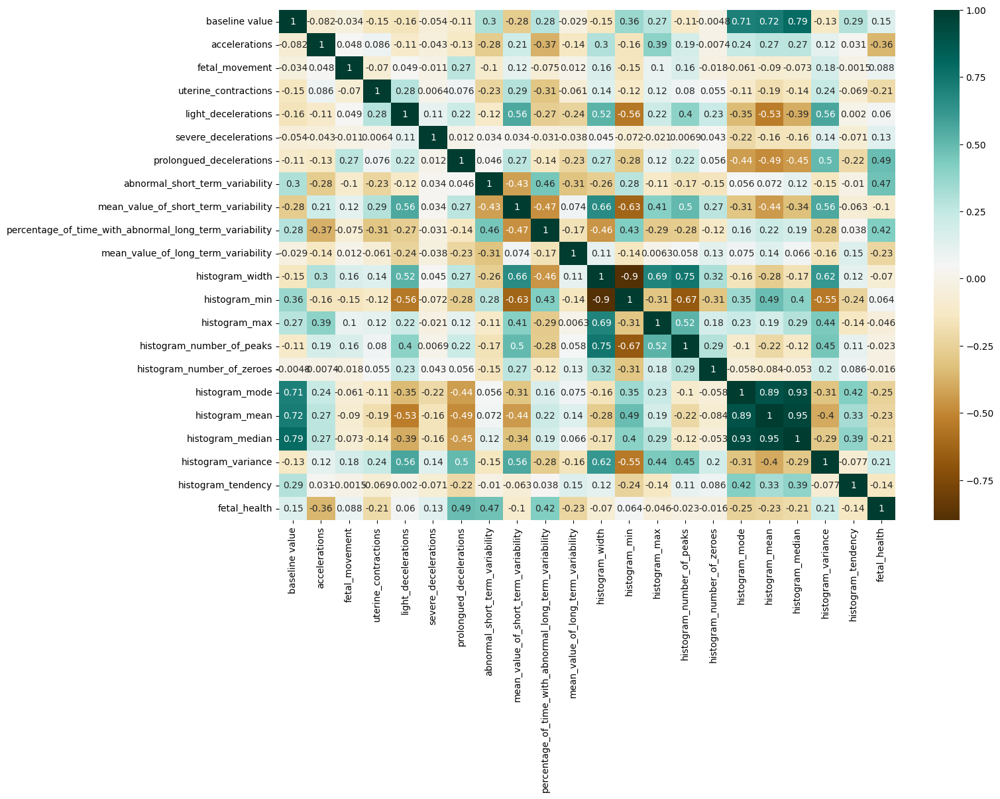

In [160]:

plt.figure(figsize=(15,10))
c = data.corr()
sns.heatmap(c,cmap="BrBG",annot=True) 

plt.show()

Our target is the fetal health so we shall look of for the feature that are highly corelated to it.

Using the lower plot we can see that prolongued_decelerations,abnormal_short_term_variability and percentage_of_time_with_abnormal_long_term_variability 
are hihgly corelated to fetal_health.


In [161]:
features = data.corr()["fetal_health"].sort_values(ascending=False).head(20).to_frame()

cm = sns.light_palette("#006400", as_cmap=True)

style = features.style.background_gradient(cmap=cm)
style

,fetal_health
fetal_health,1.000000
prolongued_decelerations,0.486752
abnormal_short_term_variability,0.469671
percentage_of_time_with_abnormal_long_term_variability,0.421634
histogram_variance,0.208171
baseline value,0.146077
severe_decelerations,0.132408
fetal_movement,0.088057
histogram_min,0.063529
light_decelerations,0.059651


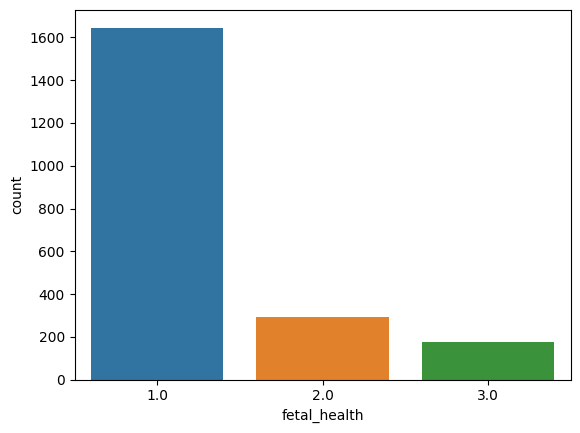

In [162]:
#whole dataset is summarised as 1.Normal, 2.Suspect, 3 Pathological
# and after its tagged as Fetal health having the 1,2 and 3
# count plot on two categorical variable
sns.countplot(x ='fetal_health', data = data)

# Show the plot
plt.show()

the relationship between the "abnormal_short_term_variability" and "fetal_movement" 
variables from the data DataFrame. The color of the points is determined by the "fetal_health" variable.

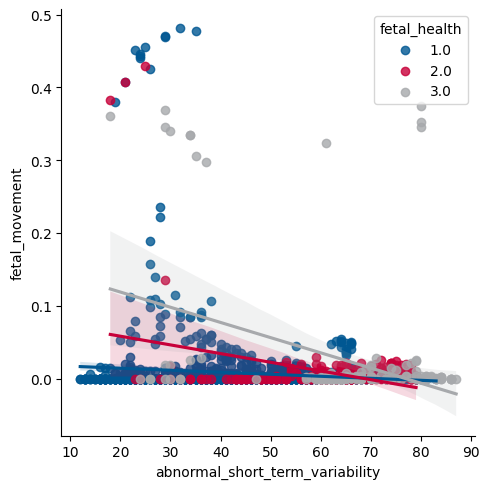

In [163]:
# custom color palette for the plot
colours = ["#005792", "#C70039", "#A7A9AC"]


sns.lmplot(data =data, x="abnormal_short_term_variability",
           y="fetal_movement",palette = colours,
           hue="fetal_health",legend_out=False)
plt.show()

 scatter plot with a linear regression line using Seaborn's lmplot function. , respectively. prolongued_decelerations against fetal movement.
 The hue argument is used to differentiate the data points based on the fetal_health variable, which is represented by different colors

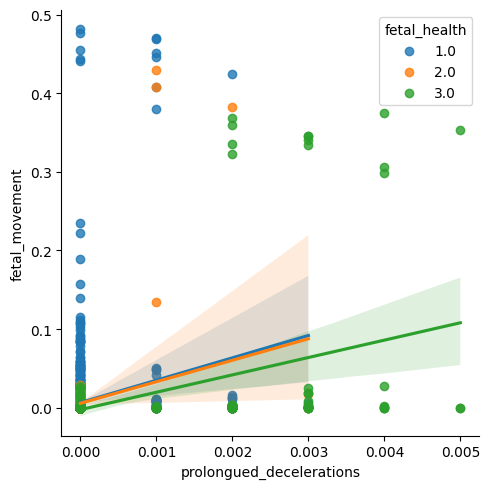

In [164]:

warnings.filterwarnings('ignore')
%matplotlib inline 
sns.lmplot(data =data,x="prolongued_decelerations",
           y="fetal_movement", hue="fetal_health",
           legend_out=False)
plt.show()

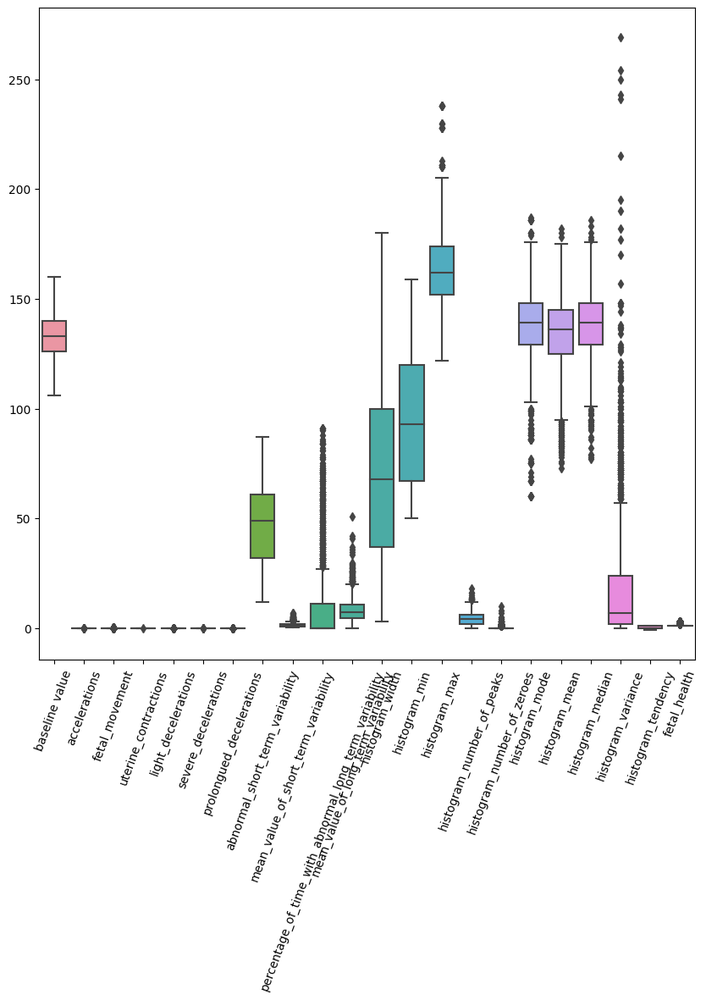

In [165]:
clrs =["#FF5733","#f7b2b0","#c98ea6","#8f7198","#50587f", "#003f5c","#C70039", "#900C3F"]
plt.figure(figsize=(10,10))
sns.boxplot(data)
plt.xticks(rotation=70)
plt.show()

    In the above plot we can learn that there is alot of variations in the data variables.
    lets standaze it such that such that they can be in the same range for better results

Model Spot-checking is a way of discovering which algorithms perform well on our machine learning problem.

You cannot know which algorithms are best suited to your problem before hand. so, we must trial a number of methods and focus attention on those that prove themselves the most promising.

In this model, we will discover 6 machine learning algorithms that you can use when spot checking our classification problem in Python with scikit-learn.

In [166]:
#lets assign values to features  F and target as T
F = data.drop(["fetal_health"],axis=1)
# The acode above creates a dataset without the feat_health
T = data["fetal_health"]

# feature standard scaler
col_names = list(F.columns)
s_scaler = preprocessing.StandardScaler()
X_dfet= s_scaler.fit_transform(F)
Xdfet = pd.DataFrame(X_dfet, columns=col_names) 
Xdfet

,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_width,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency
0,-1.352782,-0.823776,-0.203392,-1.492245,-0.641203,-0.057653,-0.26964,1.514300,-0.944425,1.811237,...,-0.167577,-1.067985,-2.123628,-0.703885,-0.460150,-1.064409,0.153804,-1.180575,1.863218,1.115505
1,-0.132665,0.726444,-0.203392,0.548605,0.370643,-0.057653,-0.26964,-1.746497,0.865205,-0.534294,...,1.524797,-0.864976,1.889542,0.651603,0.953071,0.216224,0.089729,0.131985,-0.237919,-0.521344
2,-0.030989,-0.048666,-0.203392,1.228888,0.370643,-0.057653,-0.26964,-1.804726,0.865205,-0.534294,...,1.524797,-0.864976,1.889542,0.312731,0.953071,0.216224,0.025654,-0.006179,-0.203474,-0.521344
3,0.070687,-0.048666,-0.203392,1.228888,0.370643,-0.057653,-0.26964,-1.804726,1.204511,-0.534294,...,1.191450,-1.372500,0.328865,2.345964,-0.460150,-0.027706,-0.038421,-0.075261,-0.203474,1.115505
4,-0.132665,0.984814,-0.203392,1.228888,-0.641203,-0.057653,-0.26964,-1.804726,1.204511,-0.534294,...,1.191450,-1.372500,0.328865,1.668219,-0.460150,-0.027706,0.089729,-0.006179,-0.272364,1.115505
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2108,0.680746,-0.823776,-0.203392,0.888747,-0.641203,-0.057653,-0.26964,1.863671,-1.283731,0.829387,...,-0.782986,1.469633,0.719034,-0.026141,-0.460150,0.948014,0.986778,0.960970,-0.582368,-0.521344
2109,0.680746,-0.565406,-0.203392,0.888747,-0.641203,-0.057653,-0.26964,1.805442,-1.057527,0.665745,...,-0.116293,0.319246,0.273126,0.651603,-0.460150,0.887031,0.858628,0.891888,-0.547923,1.115505
2110,0.680746,-0.565406,-0.203392,0.888747,-0.641203,-0.057653,-0.26964,1.863671,-1.057527,0.556650,...,-0.090651,0.319246,0.328865,0.312731,-0.460150,0.948014,0.858628,0.960970,-0.513478,1.115505
2111,0.680746,-0.565406,-0.203392,0.548605,-0.641203,-0.057653,-0.26964,1.805442,-1.057527,0.938481,...,-0.116293,0.319246,0.273126,0.651603,-0.460150,0.887031,0.794553,0.891888,-0.513478,1.115505


In [167]:
#feature shape
F.shape
T.shape

(2113,)

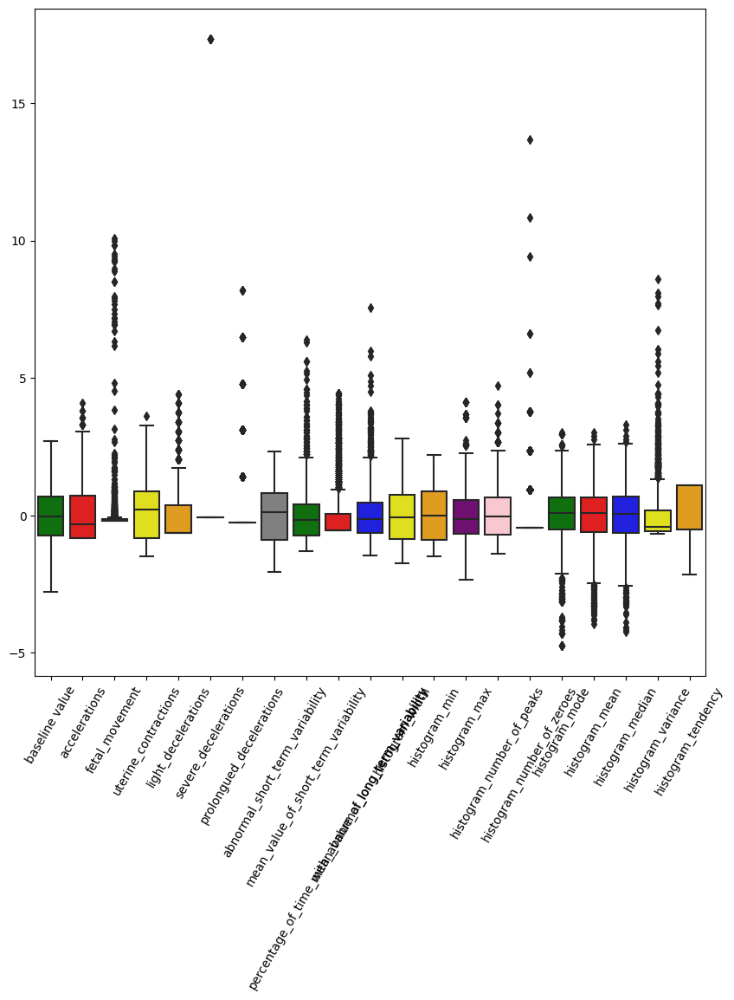

In [168]:
# lets get the cool colors to use in the box plot
clr= ["#008000","#FF0000","#0000FF","#FFFF00", "#FFA500", "#800080","#FFC0CB","#808080"]
plt.figure(figsize=(10,10))
sns.boxplot(data=Xdfet, palette=clr)
plt.xticks(rotation=60)
plt.show()

In [170]:
X_train, X_test, y_train,y_test = train_test_split(Xdfet,T,test_size=0.2,random_state=40)

In [171]:
DT_model=Pipeline([ ('dt_classifier',DecisionTreeClassifier(random_state=42))])

LR_model=Pipeline([('lr_classifier',LogisticRegression(random_state=42))])

SVC_model=Pipeline([('svc_classifier',SVC())])

RF_model=Pipeline([('rf_classifier',RandomForestClassifier())])

KNN_model = Pipeline([('knn_classifier', KNeighborsClassifier(n_neighbors=5))])

LDA_model = Pipeline([('lda', LinearDiscriminantAnalysis())])

# List of all the pipelines
pipelines = [DT_model, LR_model, SVC_model, RF_model,KNN_model, LDA_model]

# Dictionary of pipelines and classifier types for ease of reference
pipe_dict = {0: 'LinearRegression', 
             1: 'Decision Tree', 
             2: 'RandomForest', 
             3: "SuportVectorC", 
             4: "KNClassifier", 
             5: "Logistic Regression", 
            }


# Fit the pipelines
for pipe in pipelines:
    pipe.fit(X_train, y_train)

#cross validation on accuracy 
cv_results_accuracy = []
for i, model in enumerate(pipelines):
    cv_score = cross_val_score(model, X_train,y_train, cv=10 )
    cv_results_accuracy.append(cv_score)
    print("%s: %f " % (pipe_dict[i], cv_score.mean()))

LinearRegression: 0.911243 
Decision Tree: 0.891716 
RandomForest: 0.908876 
SuportVectorC: 0.936686 
KNClassifier: nan 
Logistic Regression: 0.872781 


In [173]:
pred_rf_model = RF_model.predict(X_test)
accuracy = accuracy_score(y_test, pred_rf_model)

print("The random forest score is: {:.3f}".format(accuracy))

The random forest score is: 0.929


In [174]:
confusion = confusion_matrix(y_test, pred_rf_model)
print('Confusion Matrix:\n',  confusion)


Confusion Matrix:
 [[330   7   0]
 [ 14  32   2]
 [  5   2  31]]


In [175]:
from sklearn.metrics import f1_score
# calculate the F1-score using the macro parameter
f1score = f1_score(y_test, pred_rf_model, average='macro')

print("The F1-Score is: {:.2f}".format(f1score))

The F1-Score is: 0.85


In [176]:
from sklearn.metrics import f1_score
# calculate the macro parameter using  F1-score 
f1score = f1_score(y_test, pred_rf_model, average='macro')

print("The F1-Score is: {:.2f}".format(f1score))
from sklearn.metrics import recall_score
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier


# calculate the recall for class 0 

#using mcro parameter
recall = recall_score(y_test, pred_rf_model, labels=[i], average='macro')

print(" recall for the three classes: {:.2f}".format(recall))


The F1-Score is: 0.85
 recall for the three classes: 0.00


In [ ]:

from scipy import stats

# legts calculate the Z-score 
z_scores = stats.zscore(data)

# now we identify outliers as points with a Z-score > than 3 or less than -3
outliers = np.abs(z_scores) > 3

# remove outliers from the DataFrame
outliers = data[~outliers.any(axis=1)]


In [177]:
#assigning values: F foe feature and target T
F = outliers.drop(["fetal_health"],axis=1)
# dataset has no the feat_health
T = outliers["fetal_health"]

# standard scaler for the features
col_names = list(F.columns)
s_scaler = preprocessing.StandardScaler()
X_dfetout= s_scaler.fit_transform(F)
Xdfetout = pd.DataFrame(X_dfetout, columns=col_names) 

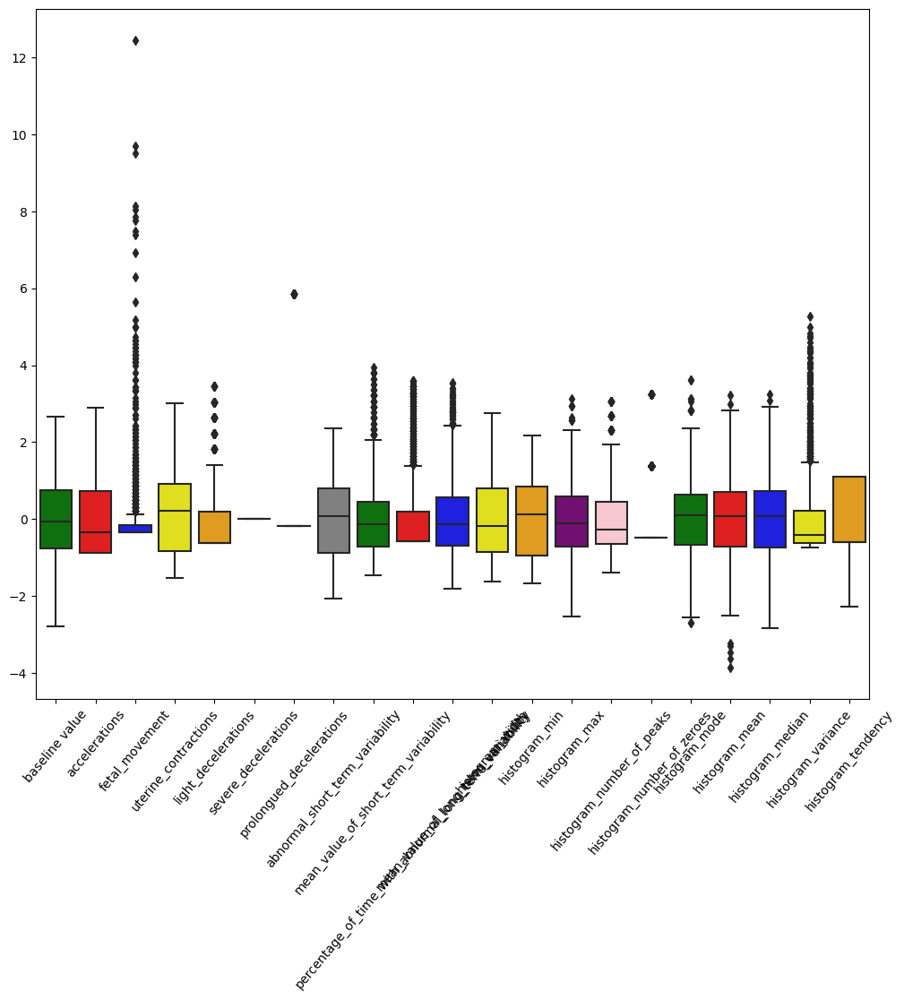

In [ ]:

plt.figure(figsize=(12,10))
sns.boxplot(data=Xdfetout, palette=clr)
plt.xticks(rotation=50)

plt.show()

# LETS split dataset 

#model selection 



In [184]:
X_trainout, X_testout, y_trainout,y_testout = train_test_split(dfetoutliers,T,test_size=0.2,random_state=40)


LR_model1=Pipeline([('lr_classifier',LogisticRegression(random_state=42))])

DT_model1=Pipeline([ ('dt_classifier',DecisionTreeClassifier(random_state=42))])

RF_model1=Pipeline([('rf_classifier',RandomForestClassifier())])

SVC_model1=Pipeline([('sv_classifier',SVC())])

KNN_model1 = Pipeline([('kn_classifier', KNeighborsClassifier(n_neighbors=5))])

LD_model1 = Pipeline([('lda', LinearDiscriminantAnalysis())])

# List of all at once
pipelines = [LR_model1, DT_model1,RF_model, SVC_model1, KNN_model1, LD_model1]

# Dictionary of pipelines and classifier types 
#it helps in referencing
pipe_dict = {0: 'LinearD_Analysis', 
             1: 'Decision Tree', 
             2: 'RandomForest', 
             3: "SVC", 
             4: "KNeighborsClassifier", 
             5: "Logistic Regression", 
            }


# Fit the pipelines
for pipe in pipelines:
    pipe.fit(X_trainout, y_trainout)

#cross validation for accuracy
cv_results_accuracy = []
for i, model in enumerate(pipelines):
    cv_score = cross_val_score(model, X_trainout,y_trainout, cv=10 )
    cv_results_accuracy.append(cv_score)
    print("%s: %f " % (pipe_dict[i], cv_score.mean()))



LinearD_Analysis: 0.936646 
Decision Tree: 1.000000 
RandomForest: 0.997158 
SVC: 0.882523 
KNeighborsClassifier: nan 
Logistic Regression: 0.900344 


So from the above we can learn that Random forests performed well with 0.99 which we can say its 
99% perfect thoug i have descision tree over fitting.
I still need some time to go through it for when we discussed with my fellow we couldnt figure it out before time.